In this notebook we will estimate the periodicity component with different parametric and non parametric methods.

In [1]:
cd(@__DIR__)
include("table_reader.jl")
include("utils/utils.jl")
include("utils/Missing_values.jl")

truncate_MV (generic function with 1 method)

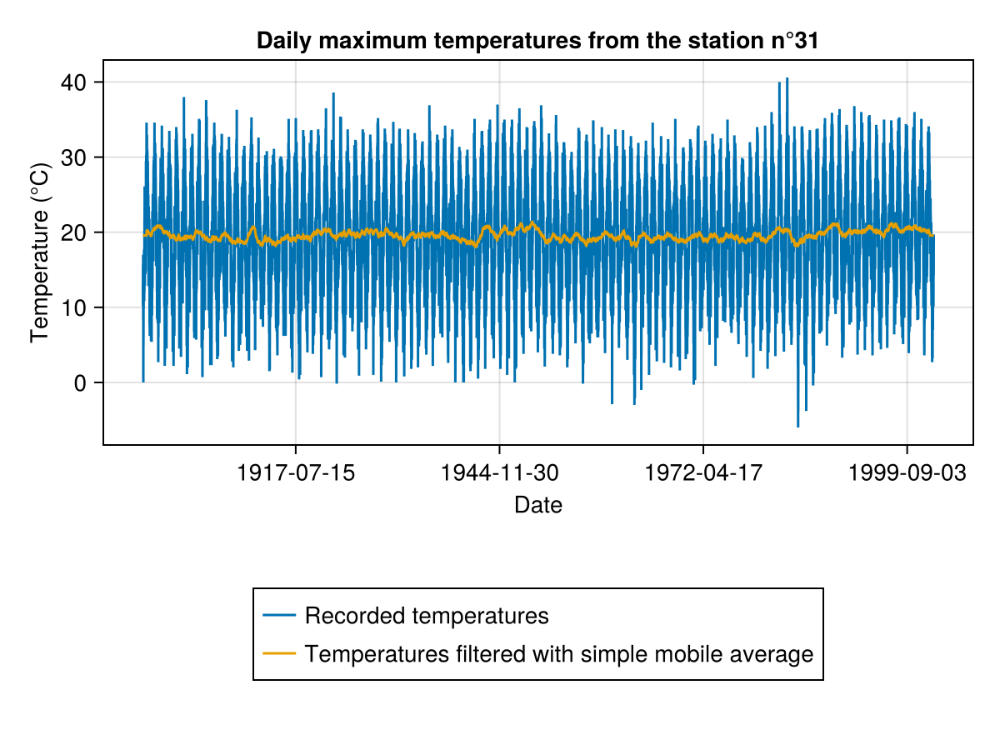

In [2]:
series,fig=extract_series("TX_STAID000031.txt",plot=true)
series=truncate_MV(series,"TX")
fig

In [3]:
include("utils/Simulation.jl")
Days_list=GatherYearScenario(series[!,2],series.DATE)
avg_day=mean.(Days_list)
max_day=maximum.(Days_list)
df_month = @chain series begin
    @transform(:TEMP = series[!,2]) #Give a common name for TX, TN, etc...
    @transform(:MONTH = month.(:DATE)) #add month column
    @by(:MONTH, :MONTHLY_MEAN = mean(:TEMP), :MONTHLY_STD = std(:TEMP), :MONTHLY_MAX = maximum(:TEMP)) # grouby MONTH + takes the mean/std in each category 
end

Row,MONTH,MONTHLY_MEAN,MONTHLY_STD,MONTHLY_MAX
,Int64,Float64,Float64,Float64
1,1,1.17685,0.332309,2.12
2,2,1.28727,0.331852,2.27
3,3,1.54382,0.311683,2.61
4,4,1.79017,0.303244,2.62
5,5,2.19996,0.325811,3.19
6,6,2.54889,0.309155,3.6
7,7,2.85561,0.300014,4.06
8,8,2.80813,0.278482,3.64
9,9,2.47622,0.280431,3.3


## Drift

MSE estimators to estimate drift

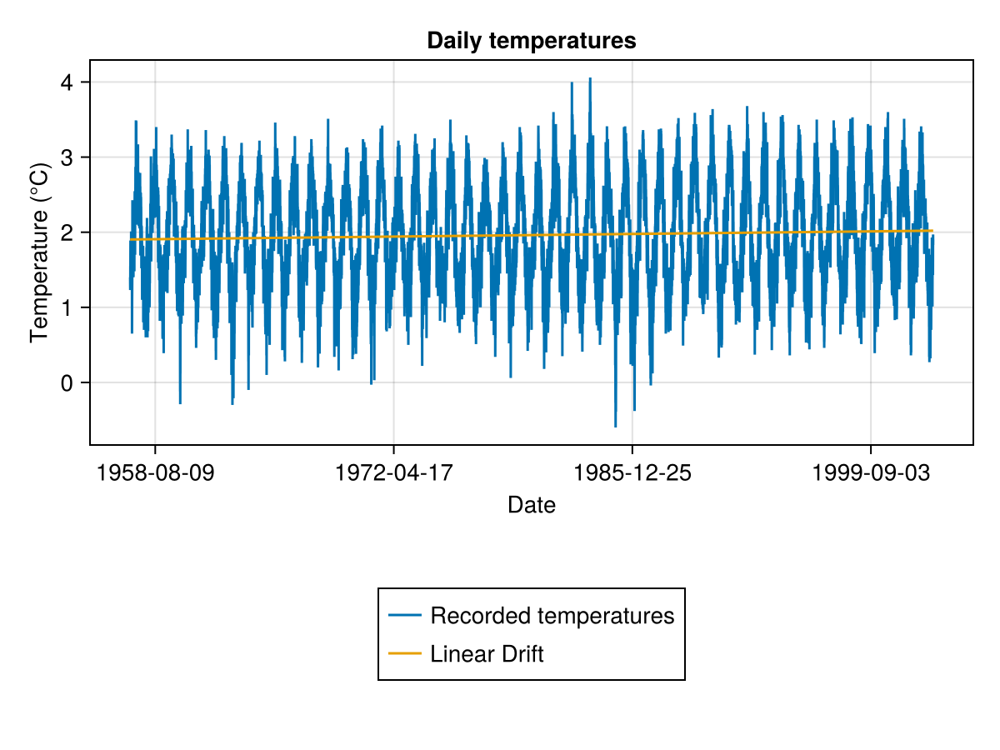

Intercept = 1.9035851526995167
Slope = 6.9346282684484405e-6


In [4]:
N=size(series)[1]
X=cat(ones(N),1:N,dims=2)
beta=inv(transpose(X)*X)*transpose(X)*series[!,2]

fig=Figure()
ax, plot1=lines(fig[1:2, 1:2], series.DATE, series[!,2])
plot2=lines!(ax,series.DATE,X*beta)
ax.title="Daily temperatures"
ax.xlabel="Date"
ax.ylabel="Temperature (°C)"
Legend(fig[3, 1:2],[plot1,plot2],["Recorded temperatures","Linear Drift"])
display(fig)

println("Intercept = $(beta[1])")
println("Slope = $(beta[2])")

We can see that the drift is (almost) only a constant. We can consider it in our periodicity component estimation, as the $\mu$ parameter.

In [5]:
try 
    using RCall
catch ; 
    import Pkg
    Pkg.add("RCall")
    using RCall
end
R"""
z<-$(series[!,2])
t<-1:$N
model<-lm(z~t)
summary(model)
"""

RObject{VecSxp}

Call:
lm(formula = z ~ t)

Residuals:
     Min       1Q   Median       3Q      Max 
-2.57415 -0.52379 -0.03542  0.55268  2.08954 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept) 1.904e+00  1.030e-02 184.860  < 2e-16 ***
t           6.935e-06  1.060e-06   6.545 6.13e-11 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Residual standard error: 0.668 on 16830 degrees of freedom
Multiple R-squared:  0.002539,	Adjusted R-squared:  0.002479 
F-statistic: 42.83 on 1 and 16830 DF,  p-value: 6.135e-11



In [6]:
# include("utils/Missing_values.jl")
# ImputeMissingValues!(series[!,2],series.DATE)
# N=length(series[!,2])

# 1.Trigonometrical parametrical model

In this model the periodicity $S_t$ will follow this equation :  $S_t = \mu + a\cos(\frac{2πt}{365.25}) + b\sin(\frac{2πt}{365.25})$. $\mu$, $a$ and $b$ will be estimated by fitting this equation on our series with an OLS regression.

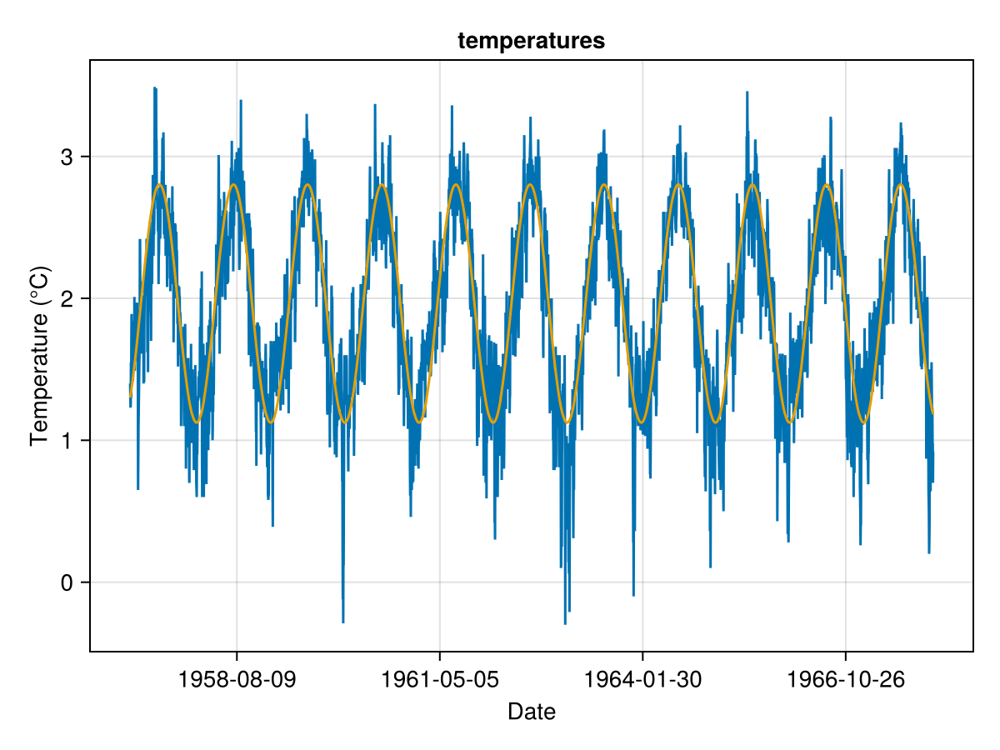

In [7]:
include("utils/periodicity.jl")
trigo_function=fitted_periodicity_fonc(series[!,2],series.DATE)
periodicity=trigo_function.(series.DATE)
period=trigo_function.(Date(0):Date(1)-Day(1))

Myyear=Iyear(series.DATE,year(series.DATE[1]):year(series.DATE[1]) + 10)
fig, ax = lines(series.DATE[Myyear],series[Myyear,2])
lines!(ax,series.DATE[Myyear],periodicity[Myyear])
ax.title="temperatures"
ax.xlabel="Date"
ax.ylabel="Temperature (°C)"
current_figure()

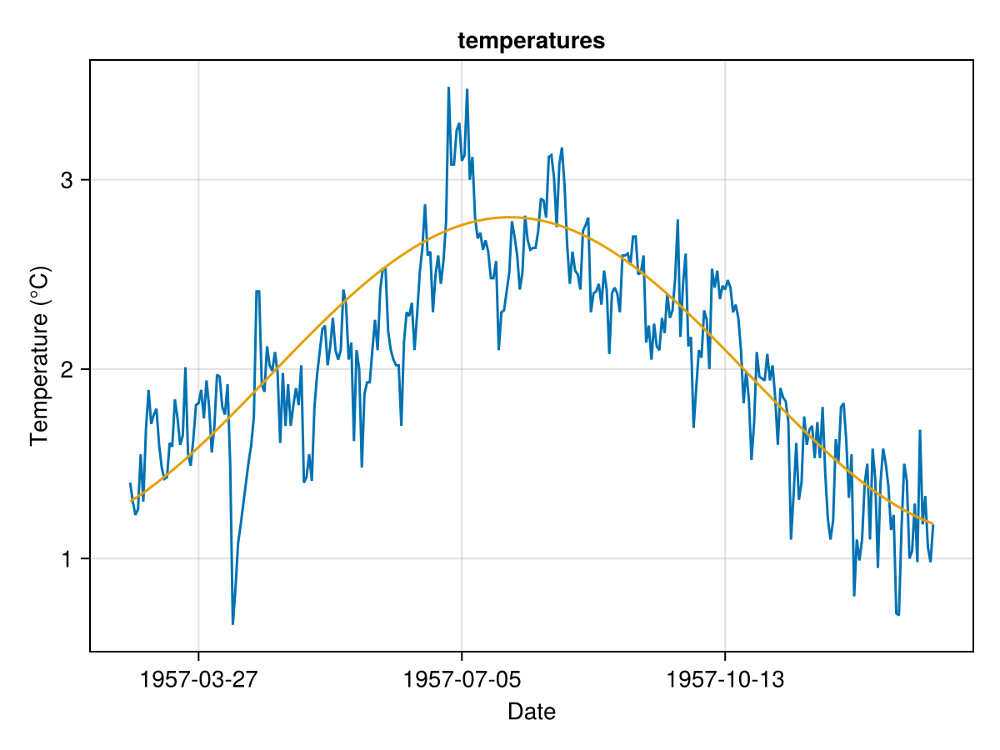

In [8]:
Myyear=Iyear(series.DATE,year(series.DATE[1]))
fig, ax = lines(series.DATE[Myyear],series[Myyear,2])
lines!(ax,series.DATE[Myyear],periodicity[Myyear])
ax.title="temperatures"
ax.xlabel="Date"
ax.ylabel="Temperature (°C)"
current_figure()

We will work on the series without the periodicity : 

In [9]:
x=series[!,2]-periodicity

16832-element Vector{Float64}:
  0.09950406097067654
 -0.009435794329203828
 -0.08856908709004108
 -0.06789311450813362
  0.21259488266408577
 -0.04710228069849243
  0.3230182650733442
  0.5229594435939104
  0.3327242315574459
  0.37231565785722043
  ⋮
  0.31269570795974033
  0.10020511241423002
 -0.05240779143168495
 -0.1451392710574213
  0.04201444114758246
  0.31905714676892316
  0.3559926802422355
  0.20282490771847095
  0.2595577259197932

In [10]:
include("utils/Estimation.jl")
Φ, σ=LL_AR_Estimation(x,1)

ERROR: LoadError: too many parameters for type AbstractInterpolation
Stacktrace:
 [1] top-level scope
   @ C:\Users\goninarn\.julia\packages\SparseConnectivityTracer\litqn\ext\SparseConnectivityTracerDataInterpolationsExt.jl:28
 [2] include
   @ .\Base.jl:557 [inlined]
 [3] include_package_for_output(pkg::Base.PkgId, input::String, depot_path::Vector{String}, dl_load_path::Vector{String}, load_path::Vector{String}, concrete_deps::Vector{Pair{Base.PkgId, UInt128}}, source::String)
   @ Base .\loading.jl:2881
 [4] top-level scope
   @ stdin:6
in expression starting at C:\Users\goninarn\.julia\packages\SparseConnectivityTracer\litqn\ext\SparseConnectivityTracerDataInterpolationsExt.jl:3
in expression starting at stdin:6
┌ Error: Error during loading of extension SparseConnectivityTracerDataInterpolationsExt of SparseConnectivityTracer, use `Base.retry_load_extensions()` to retry.
│   exception = 1-element ExceptionStack:
Failed to precompile SparseConnectivityTracerDataInterpolationsExt [

([0.7071794254080177], 0.21846543216611375)

## Autocorrelations

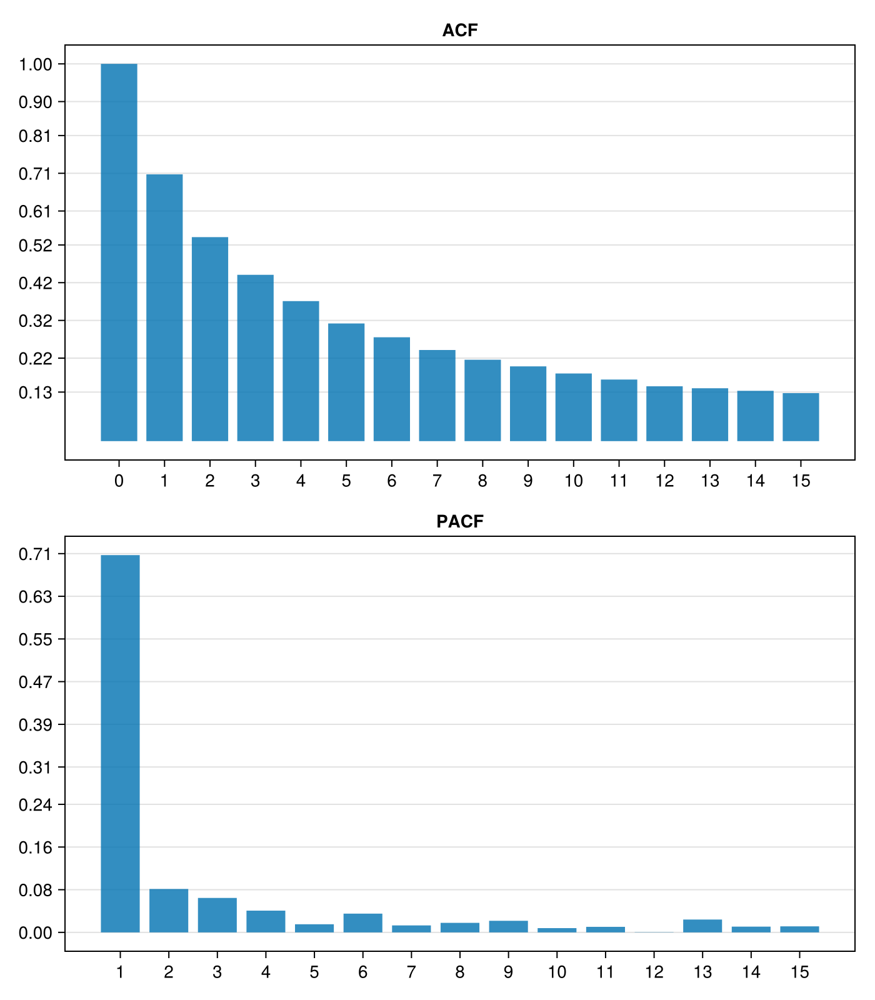

In [11]:
include("utils/ACF_PACF.jl")
ACF_PACF(x)

It still looks like an AR(1) model

## Estimation and simulation

In [12]:
include("utils/Estimation.jl")
include("utils/Simulation.jl")
include("utils/Plotting.jl")

WrapPlotMonthlyStats

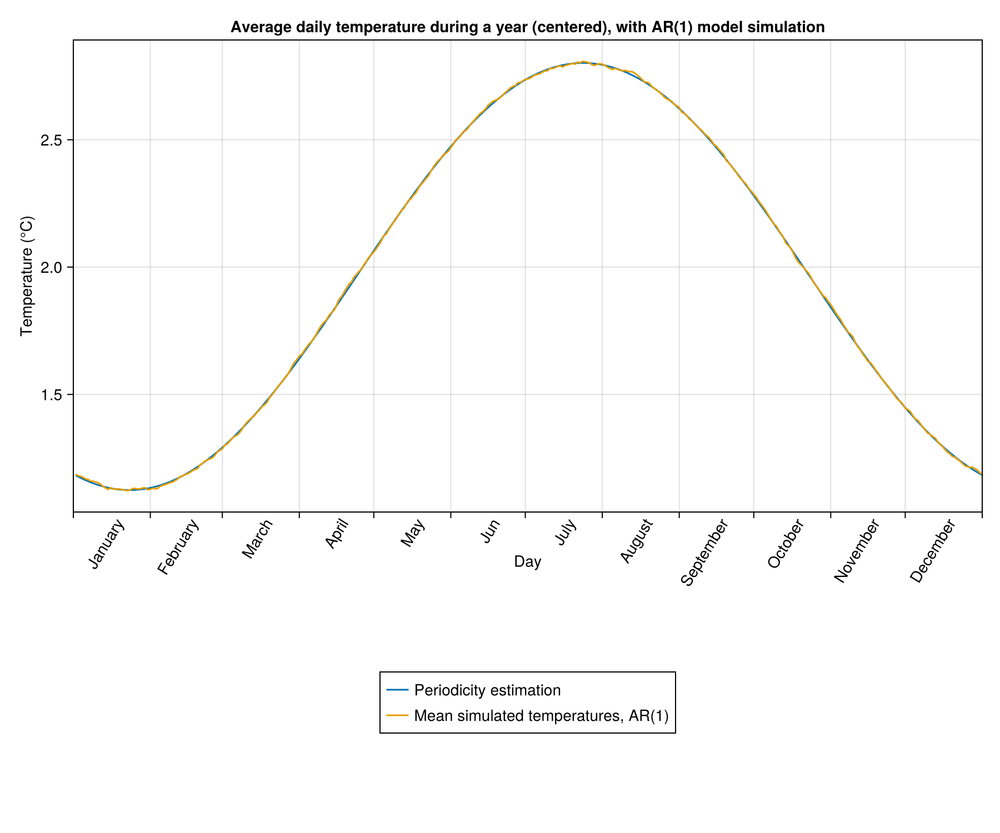

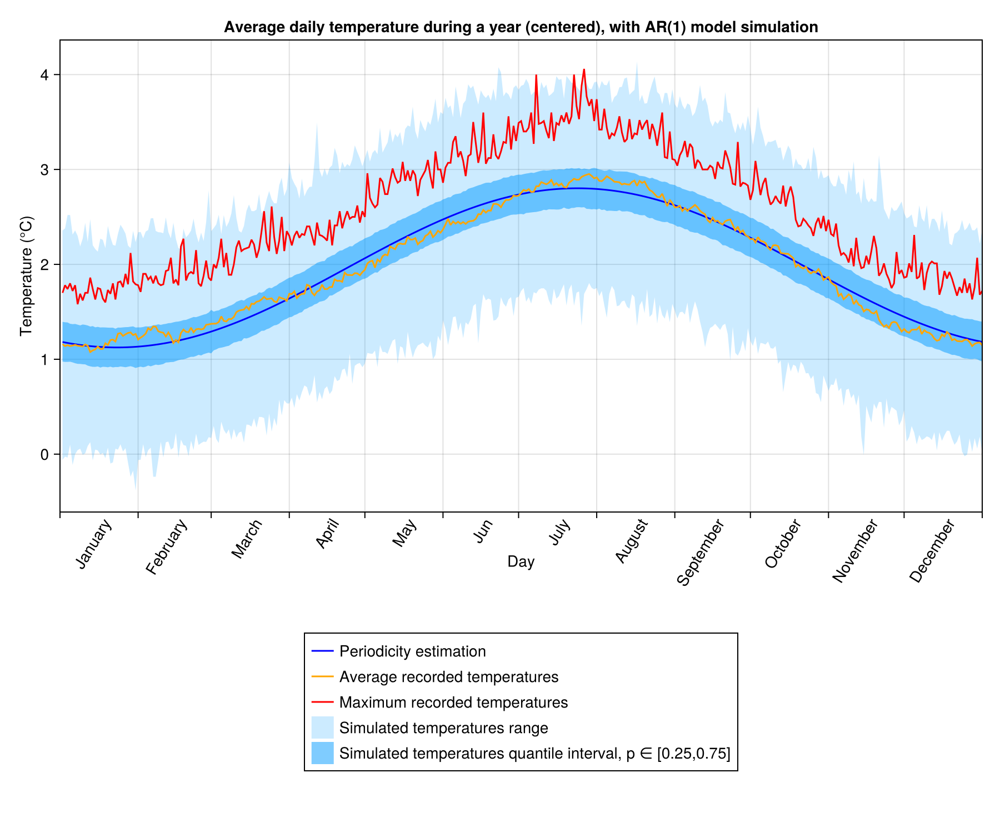

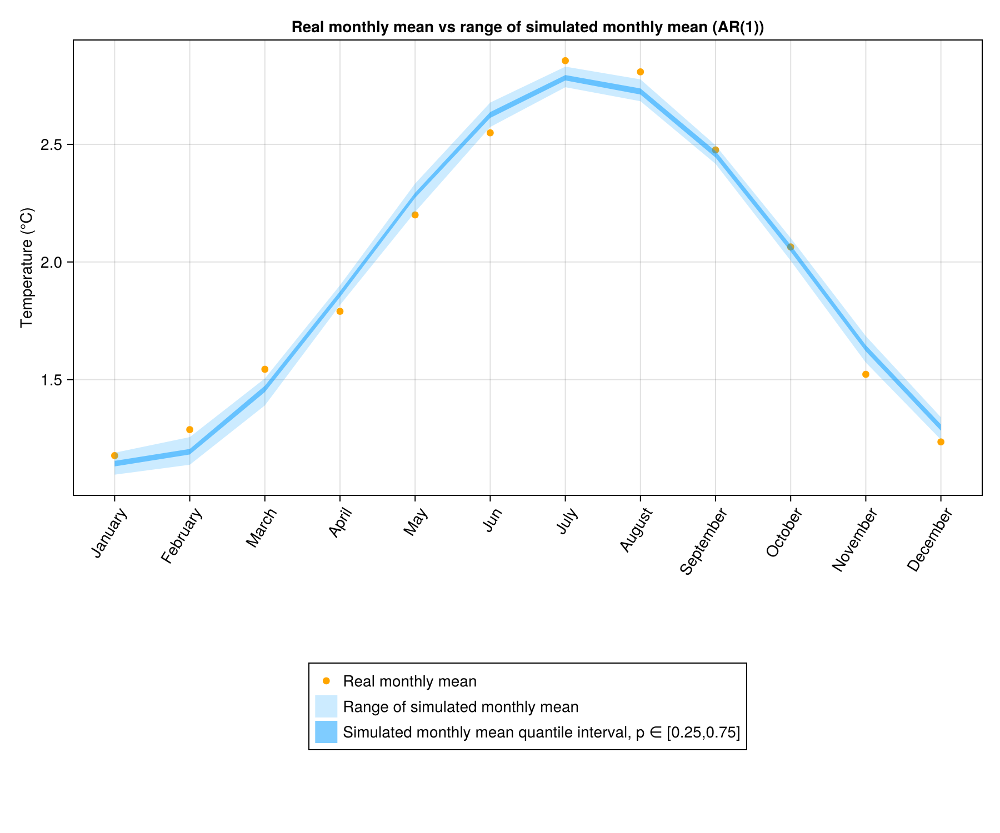

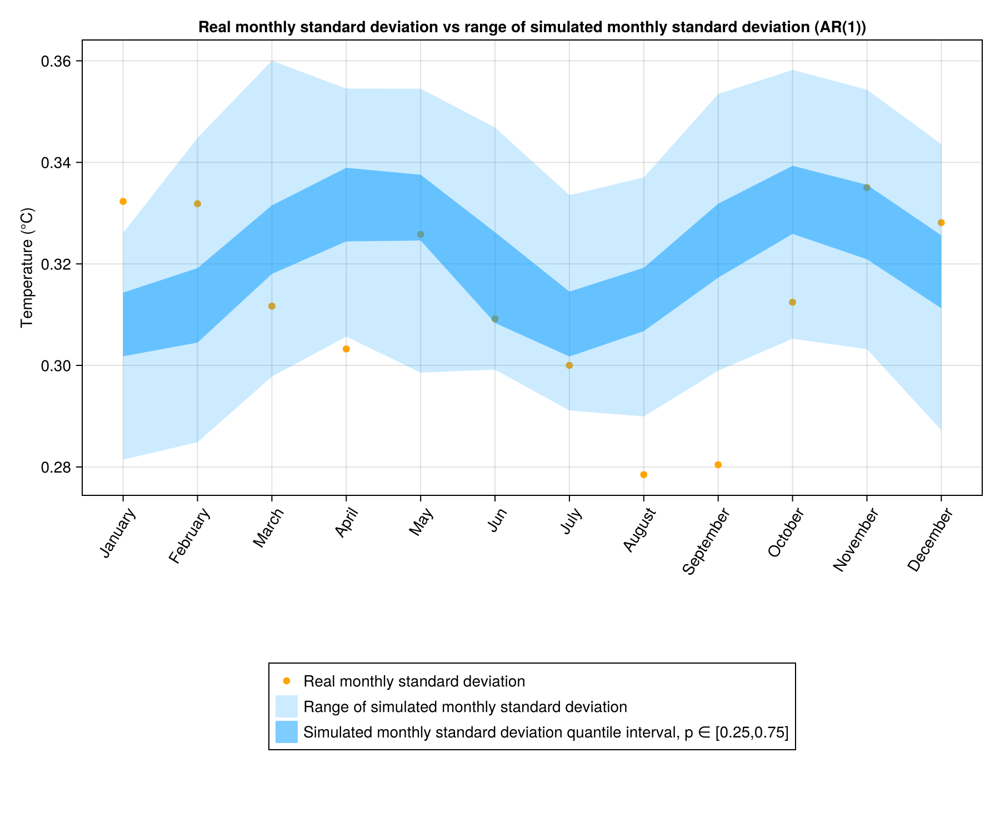

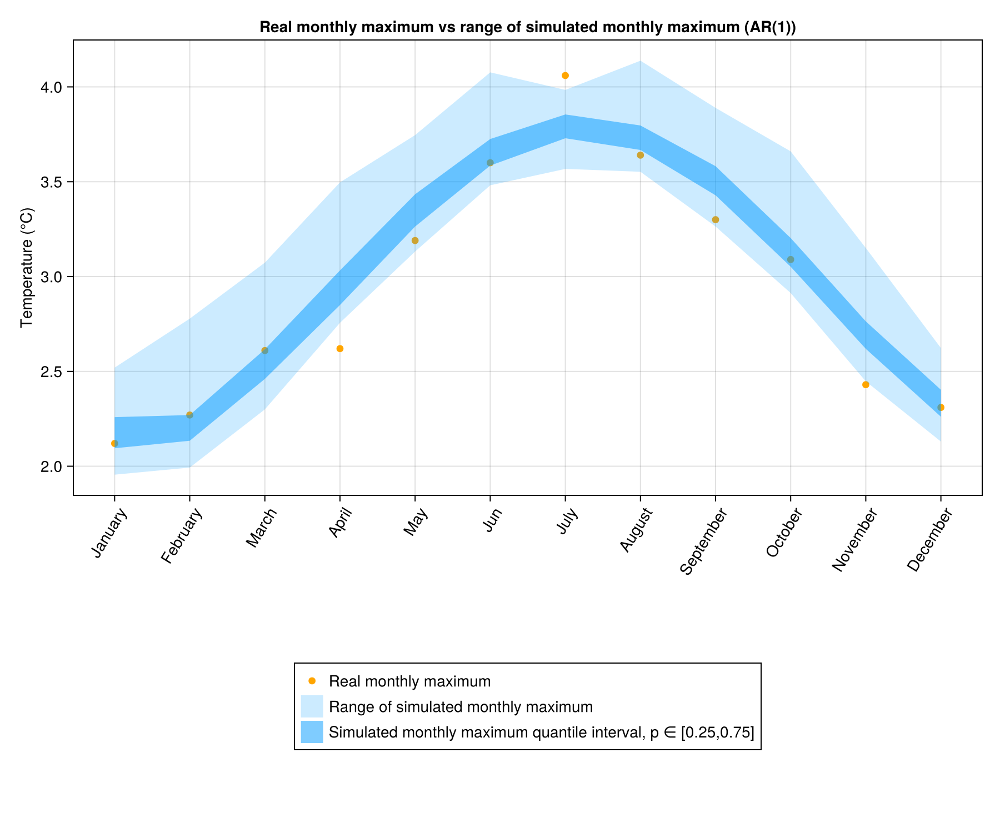

...

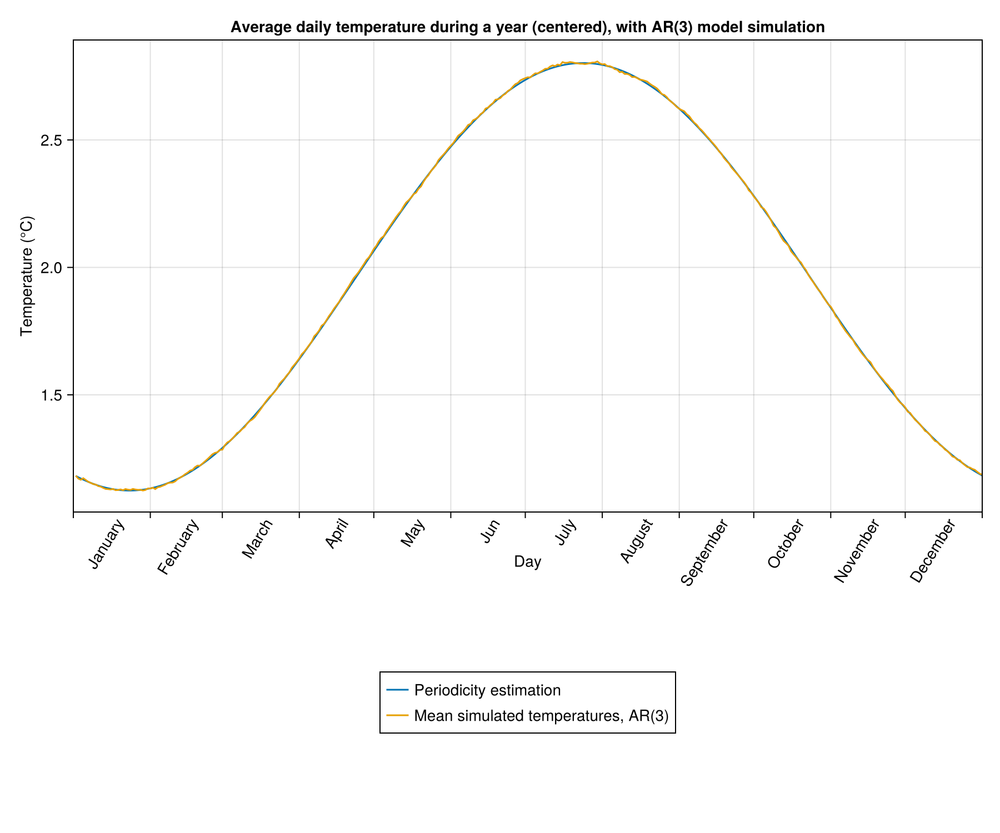

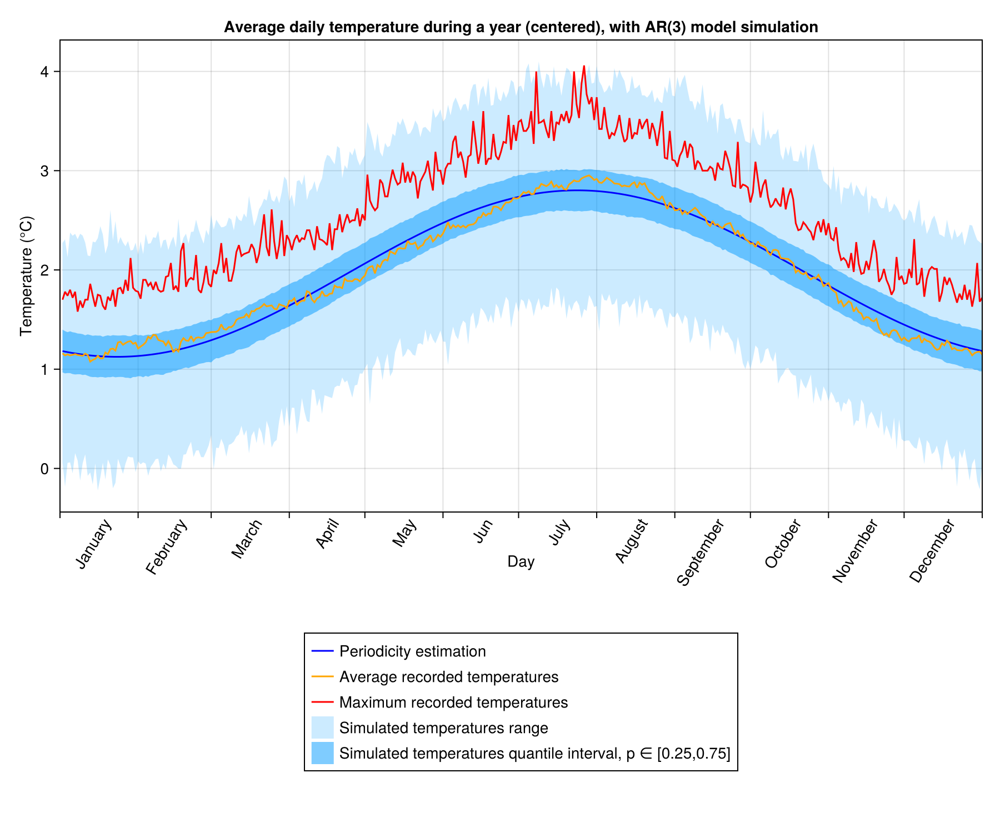

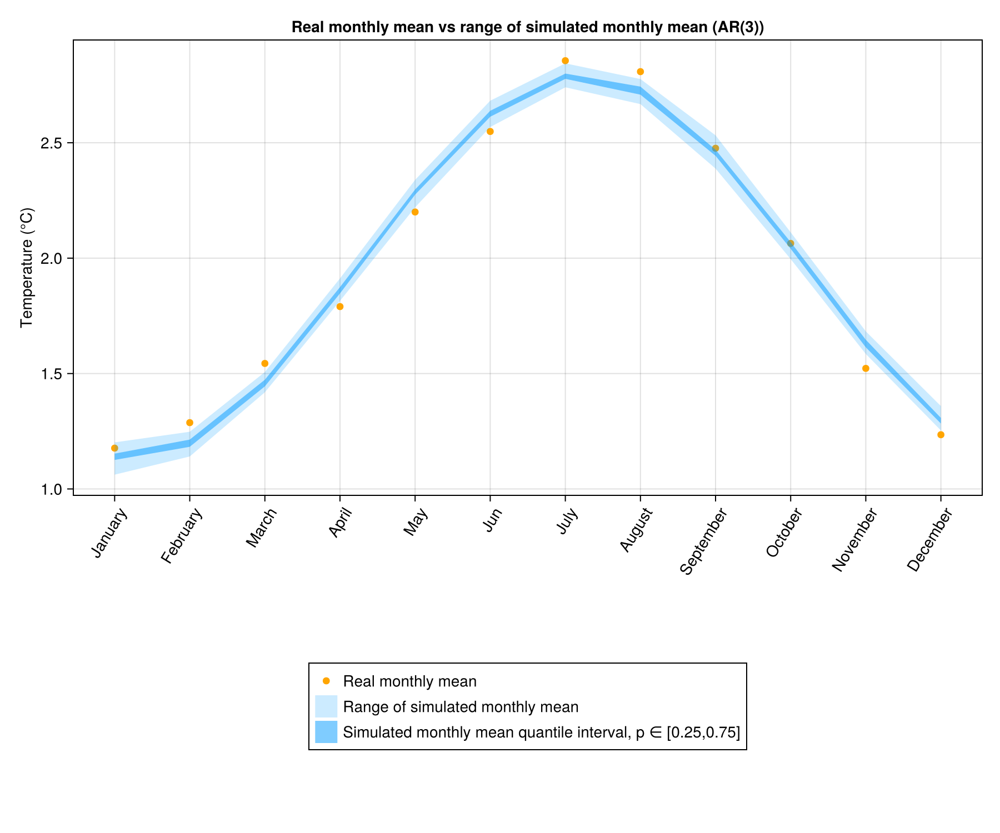

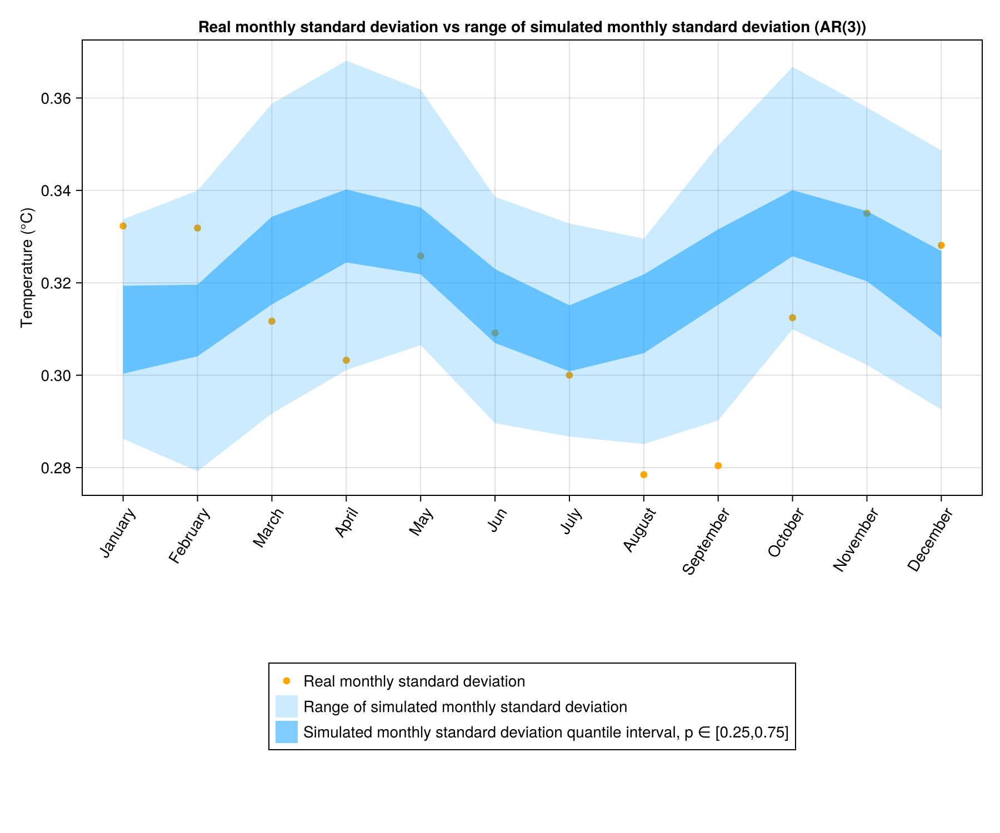

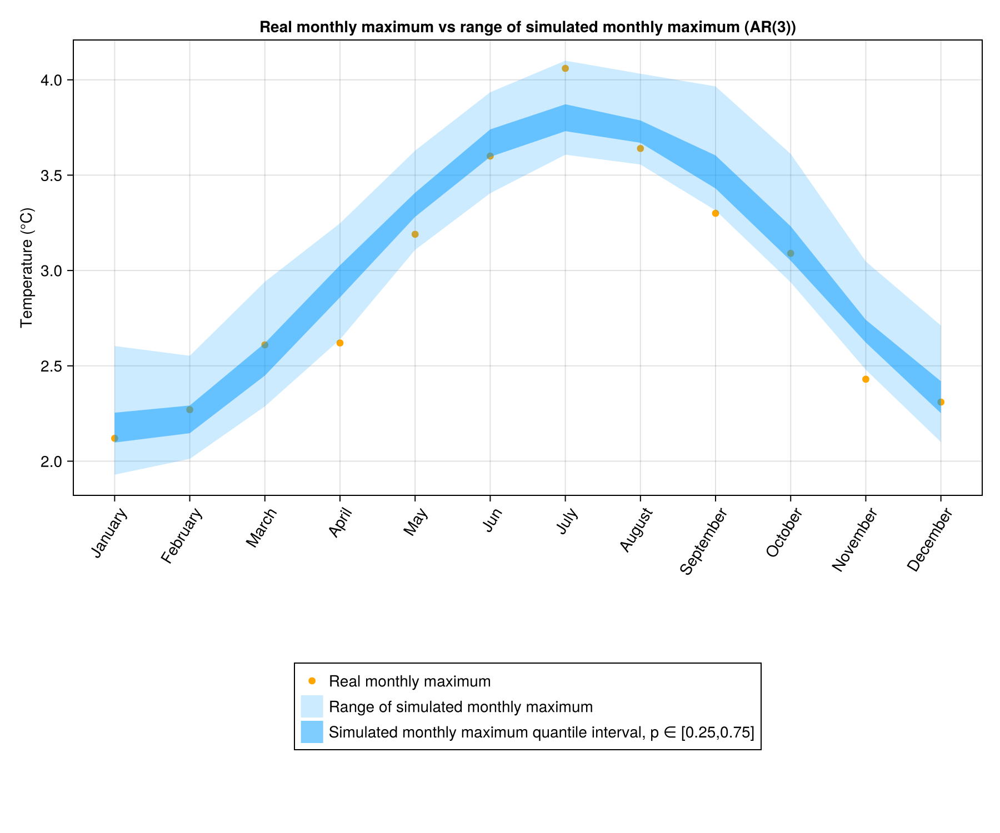

In [13]:
for p in 1:3
    Φ, σ = LL_AR_Estimation(x, p)
    sample_ = SimulateScenarios(x[1:p], series.DATE[1]:series.DATE[end], Φ, σ, period; n=100)
    year_sample = GatherYearScenarios(sample_, series.DATE[1]:series.DATE[end])
    display(PlotYearCurves([period, mean.(year_sample)], ["Periodicity estimation", "Mean simulated temperatures, AR($(p))"], "Average daily temperature during a year (centered), with AR($(p)) model simulation"))
    display(PlotYearCurves([period, avg_day, max_day],
        ["Periodicity estimation", "Average recorded temperatures", "Maximum recorded temperatures", "Simulated temperatures range", "Simulated temperatures quantile interval, p ∈ [0.25,0.75]"],
        "Average daily temperature during a year (centered), with AR($(p)) model simulation",
        [(minimum.(year_sample), maximum.(year_sample)), (quantile.(year_sample, 0.25), quantile.(year_sample, 0.75))],
        [("#009bff", 0.2), ("#009bff", 0.5)],
        colors=["blue", "orange", "red"]
    ))
    display.(WrapPlotMonthlyStats(df_month, sample_, series.DATE[1]:series.DATE[end],"(AR($(p)))"))
end

# 2.Periodicity with regularization smoothing

In this model we use regularization smoothing on the average daily temperature to make our periodicity function. 
(see : https://docs.sciml.ai/DataInterpolations/stable/methods/)

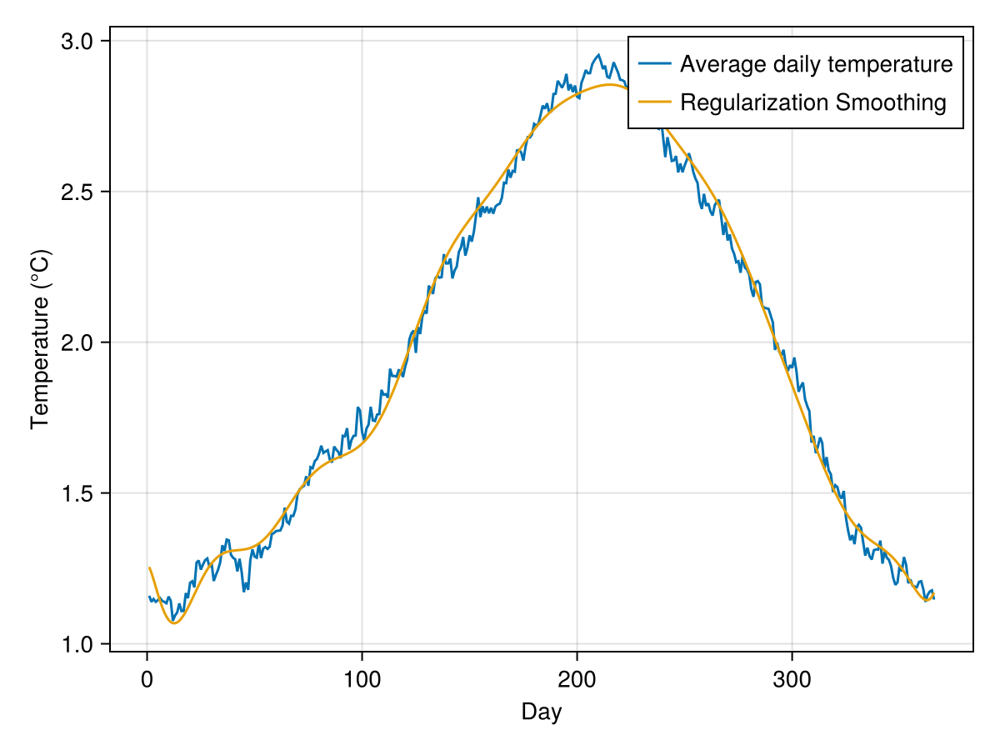

In [14]:
include("utils/Periodicity.jl")
Days_list=GatherYearScenario(series[!,2],series.DATE)

f=RegularizationSmooth(mean.(Days_list), 1:366, 9)
period=f.(dayofyear_Leap.(Date(0):Date(1)-Day(1)))
fig=Figure()
ax ,plt1= lines(fig[1:2,1:2],mean.(Days_list))
plt2=lines!(ax,f(1:366))
ax.xlabel="Day"
ax.ylabel="Temperature (°C)"
axislegend(ax,[plt1,plt2],["Average daily temperature","Regularization Smoothing"])
current_figure()

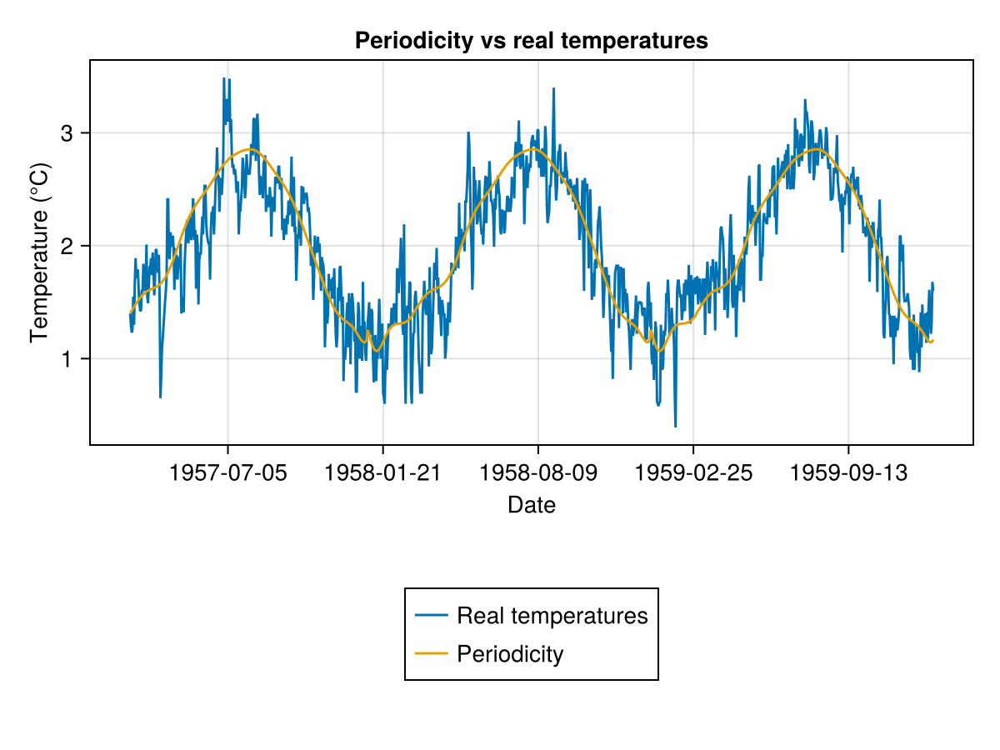

In [15]:
Smoothed_function(i)=f(dayofyear_Leap(i,series.DATE[1]))
periodicity=Smoothed_function.(1:N)

fig=Figure()
Myyear=Iyear(series.DATE,year(series.DATE[1]):year(series.DATE[1]) + 2)
ax ,plt1= lines(fig[1:2,1:2],series.DATE[Myyear],series[Myyear,2])
plt2=lines!(ax,series.DATE[Myyear],periodicity[Myyear])
ax.title="Periodicity vs real temperatures"
ax.xlabel="Date"
ax.ylabel="Temperature (°C)"
Legend(fig[3,1:2],[plt1,plt2],["Real temperatures","Periodicity"])
current_figure()

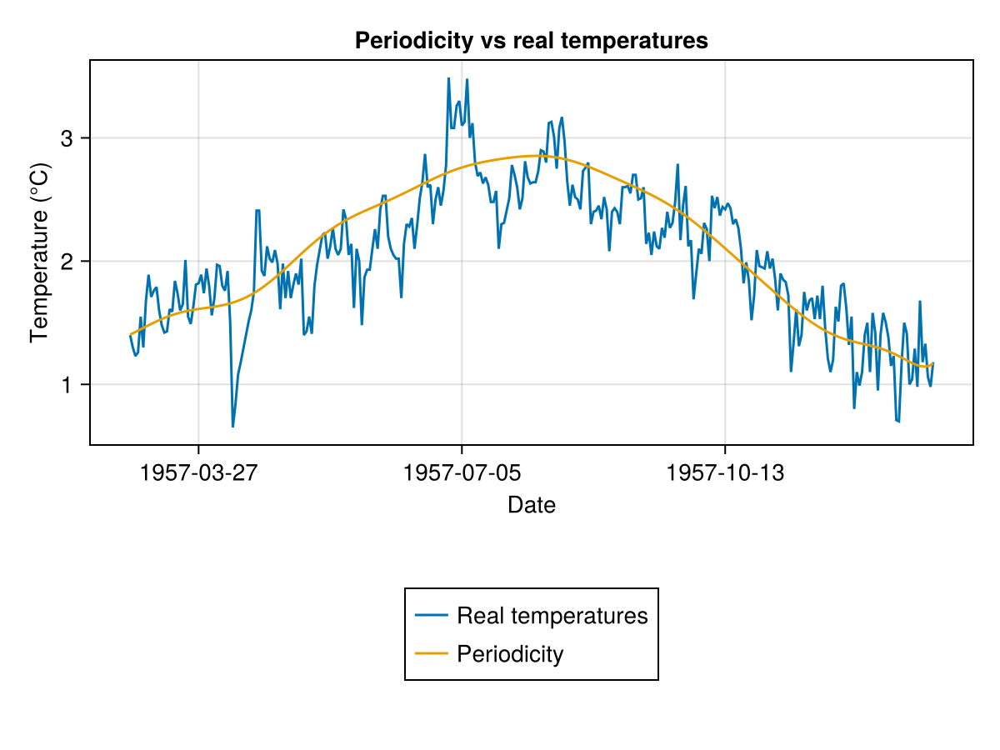

1957-03-01
1957-12-31


CairoMakie.Screen{IMAGE}


In [16]:
fig=Figure()
Myyear=Iyear(series.DATE,year(series.DATE[1]))
ax ,plt1= lines(fig[1:2,1:2],series.DATE[Myyear],series[Myyear,2])
plt2=lines!(ax,series.DATE[Myyear],periodicity[Myyear])
ax.title="Periodicity vs real temperatures"
ax.xlabel="Date"
ax.ylabel="Temperature (°C)"
Legend(fig[3,1:2],[plt1,plt2],["Real temperatures","Periodicity"])
println(series.DATE[Myyear][1])
println(series.DATE[Myyear][end])
display(fig)

## Estimation and simulation

In [17]:
include("utils/Estimation.jl")
include("utils/Simulation.jl")
include("utils/Plotting.jl")

WrapPlotMonthlyStats

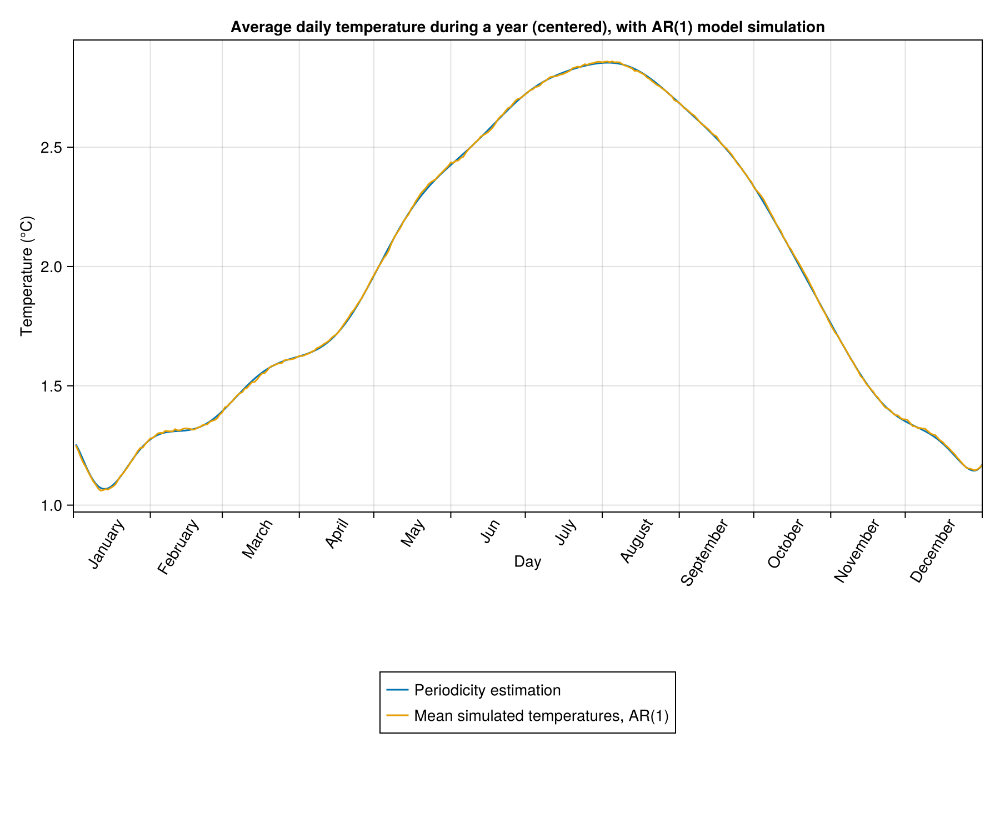

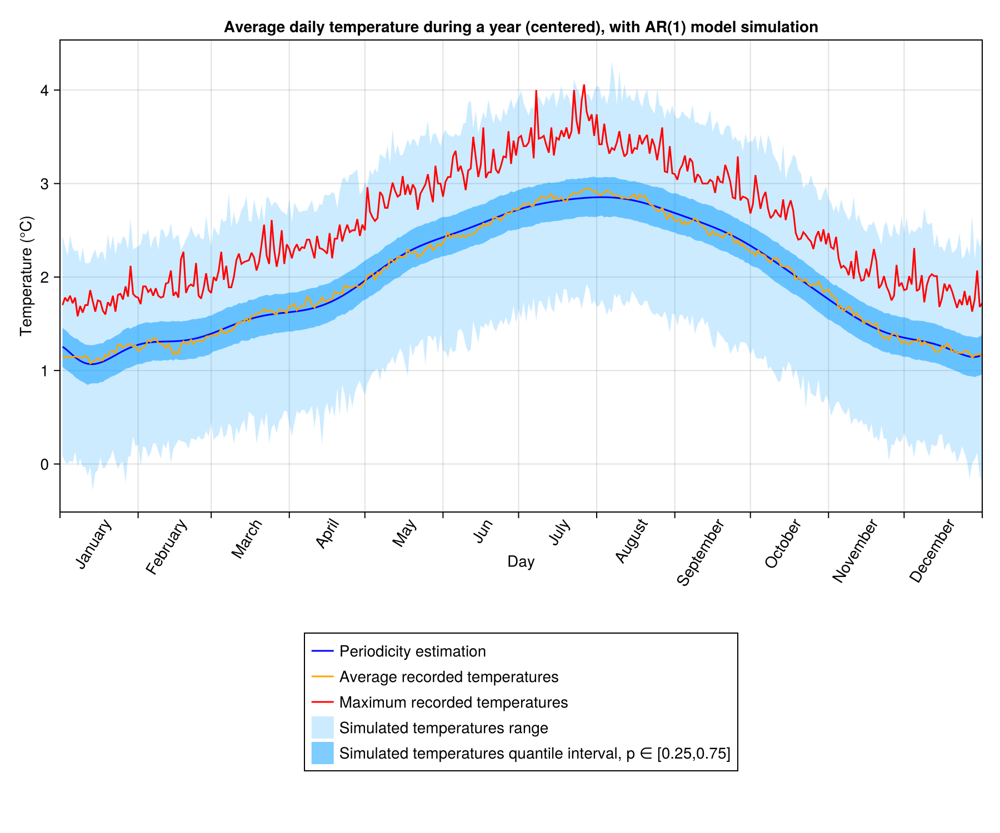

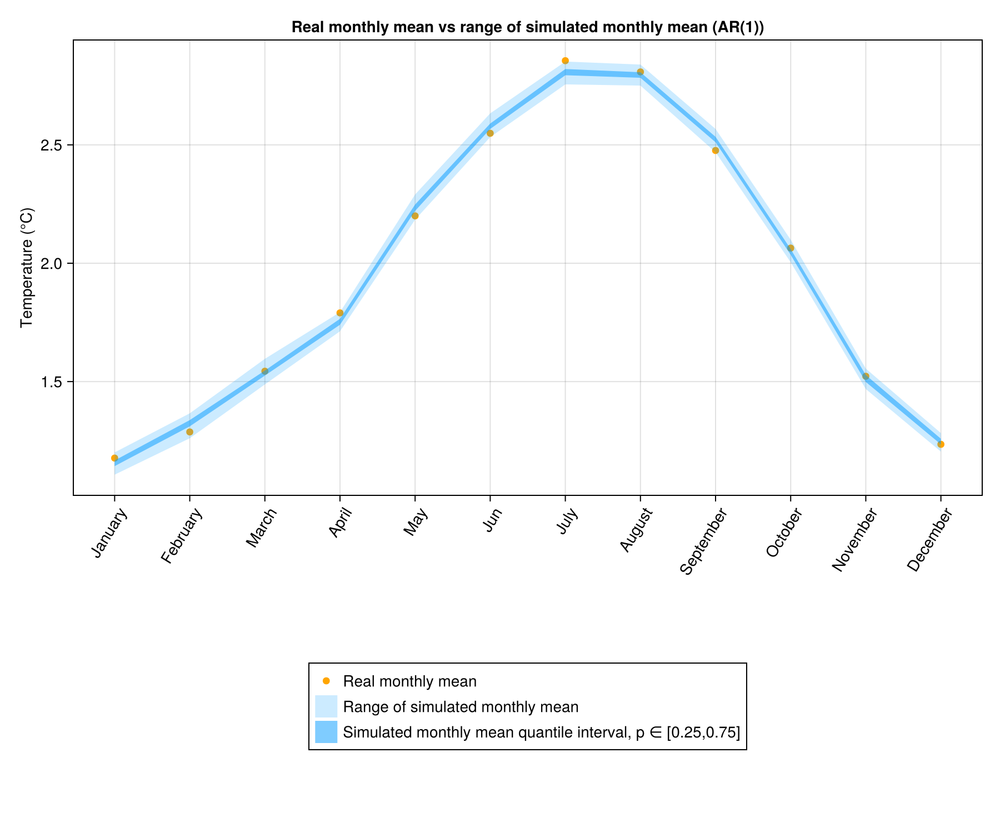

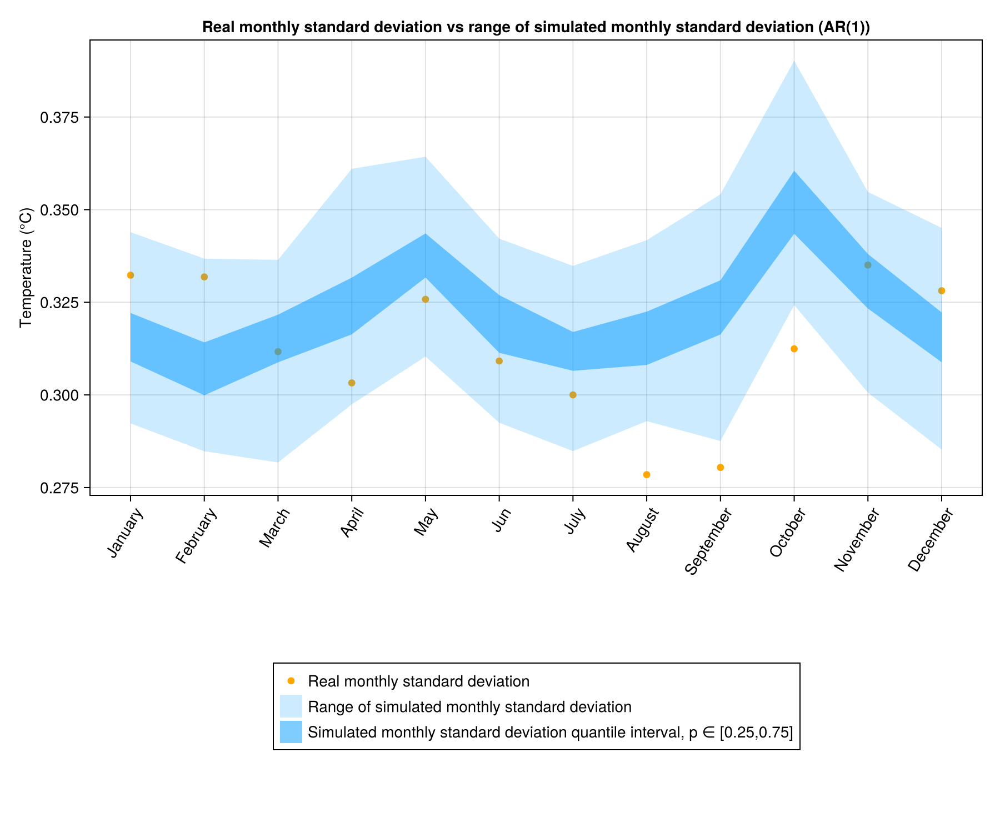

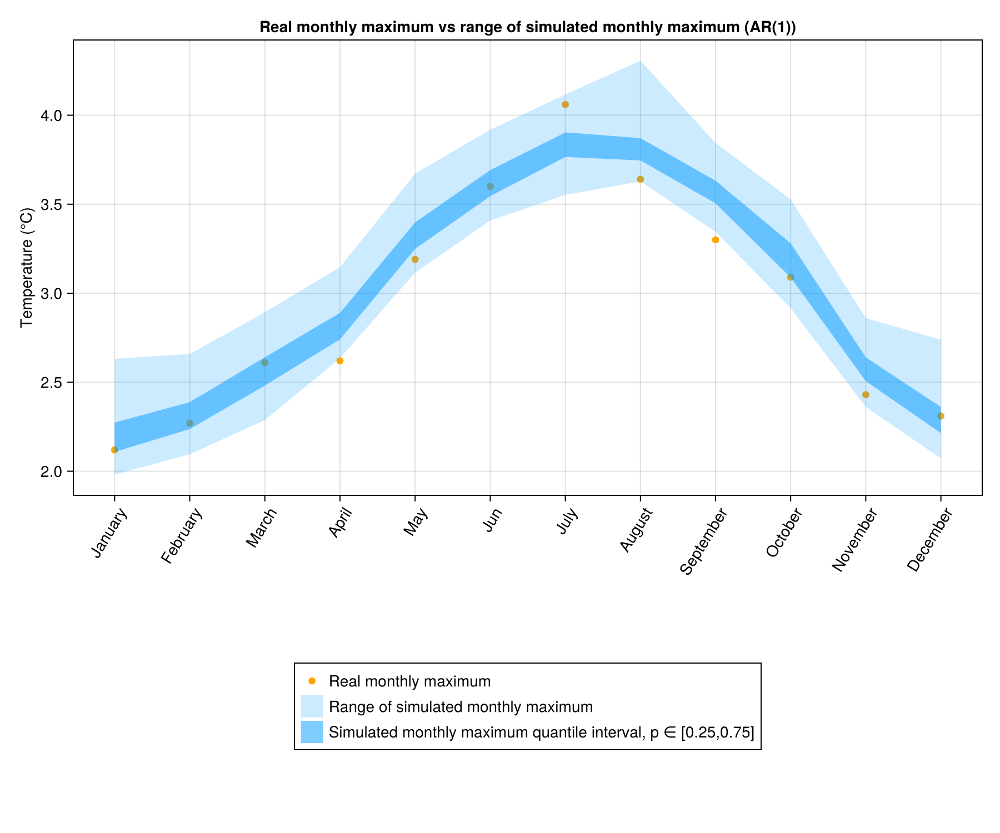

...

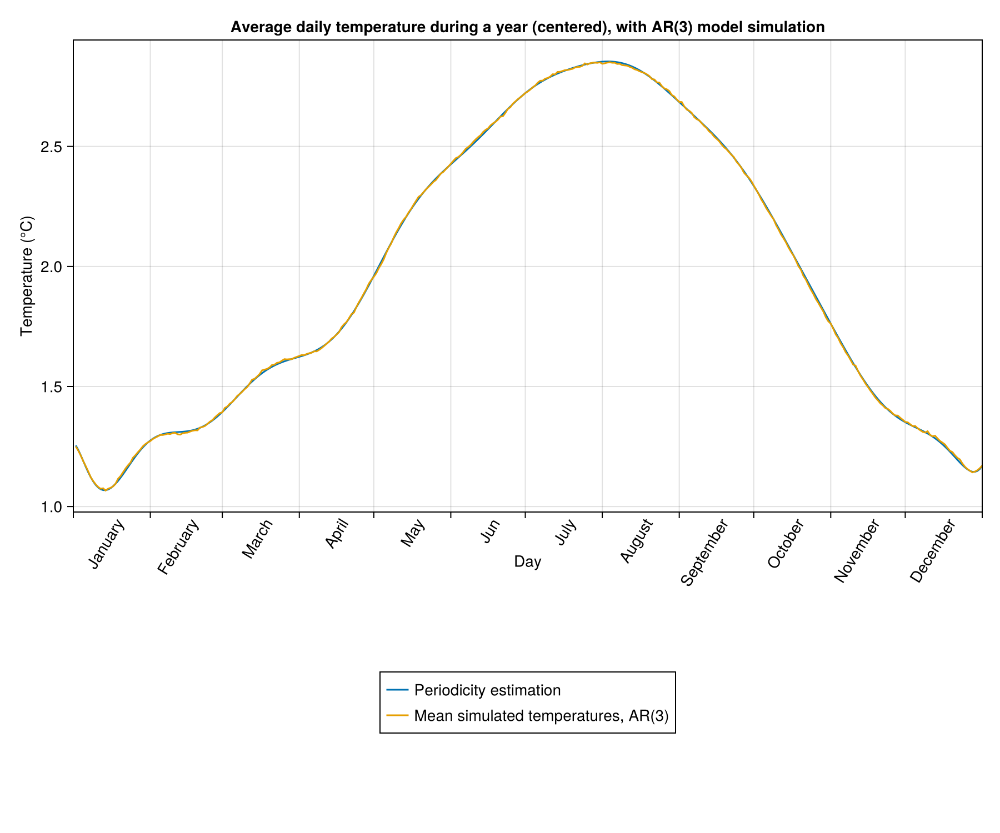

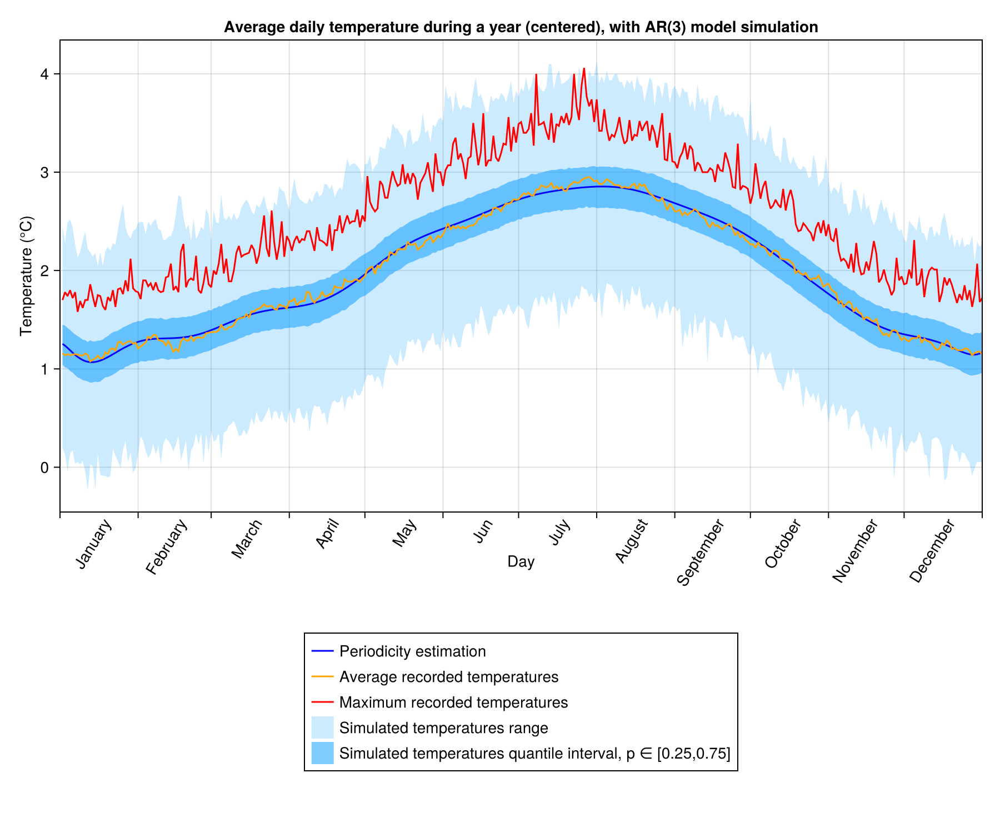

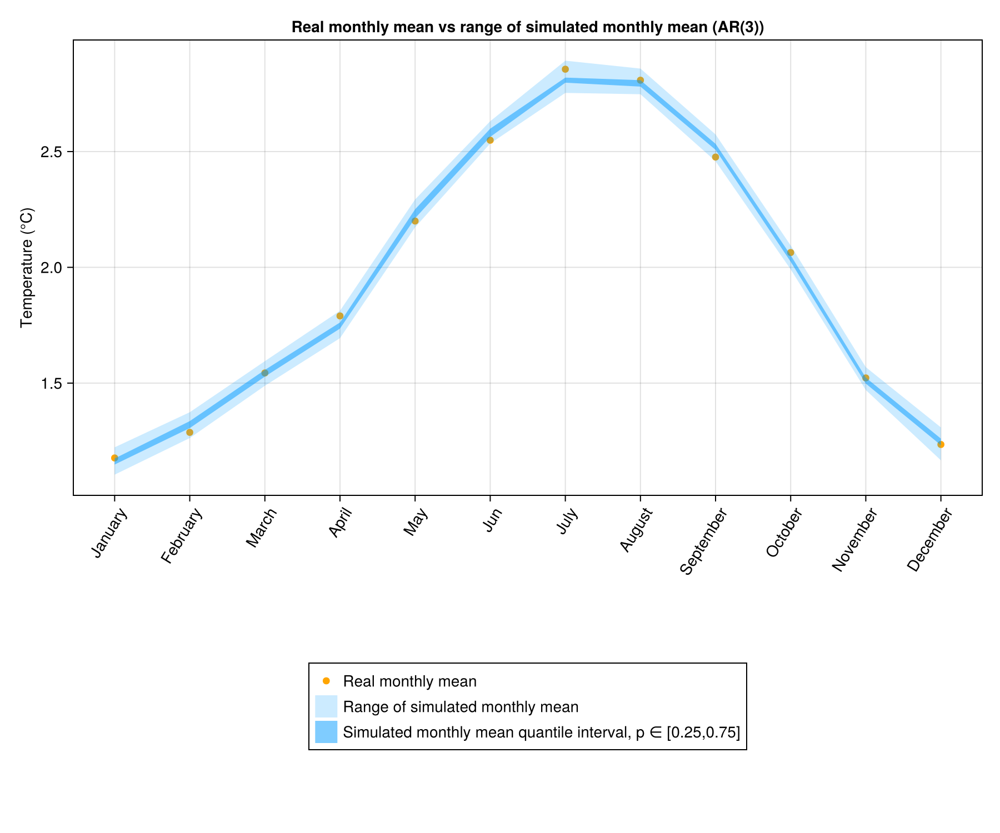

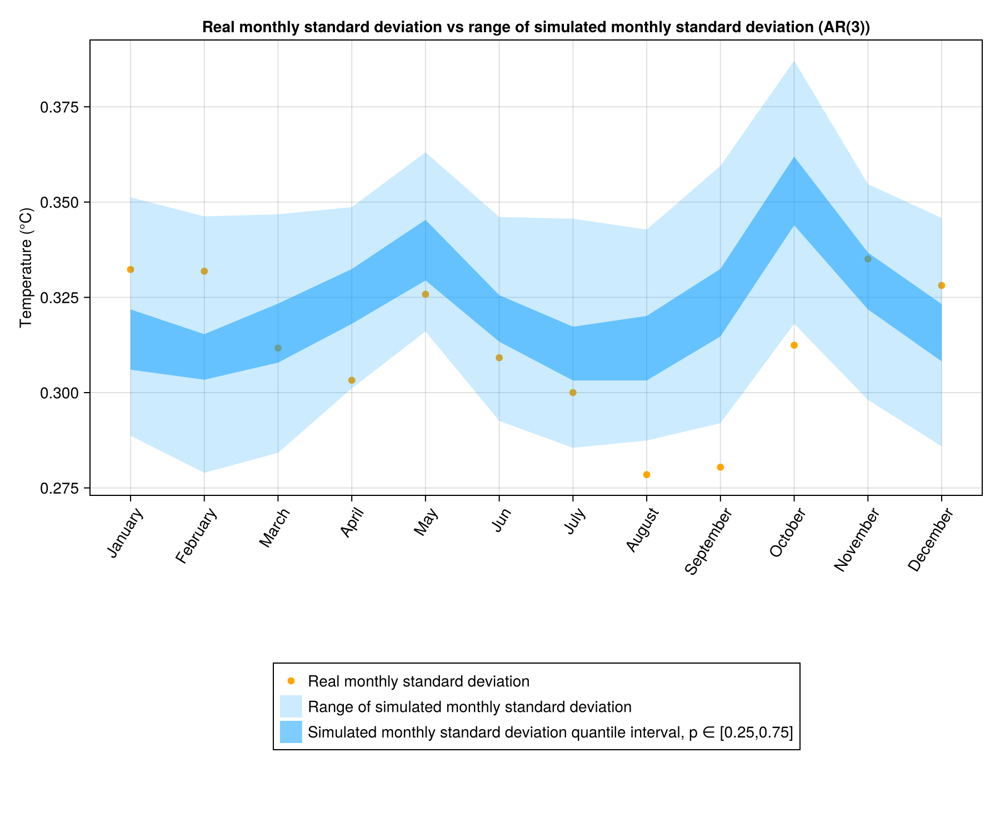

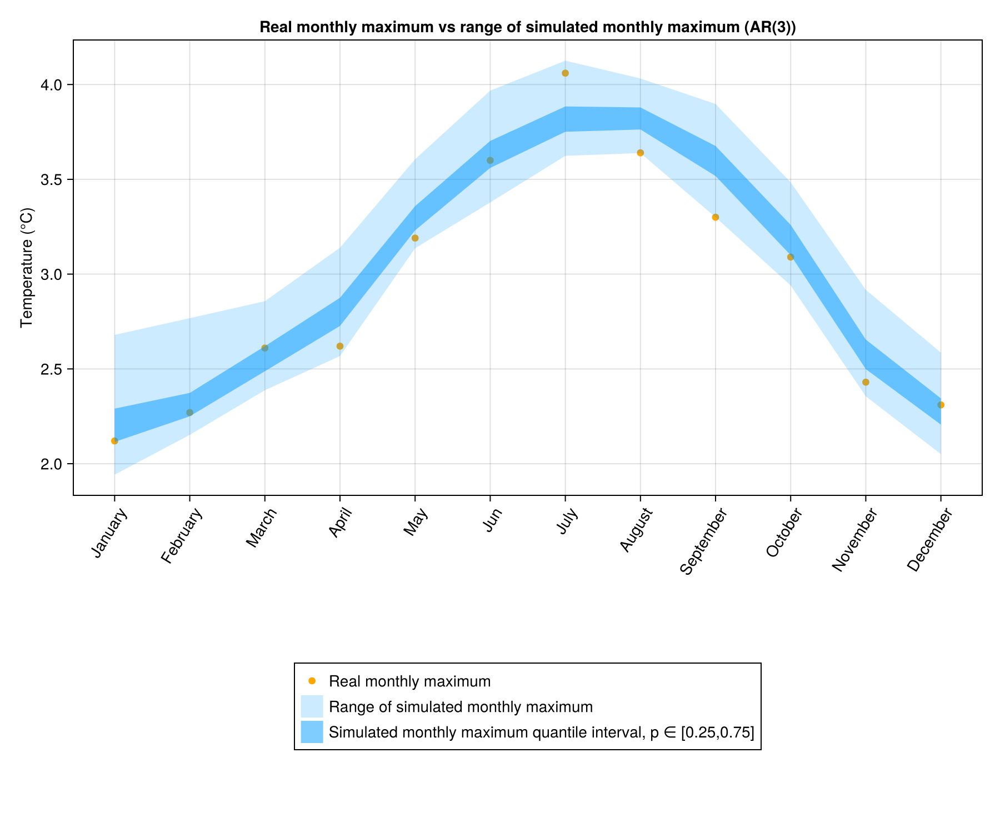

In [18]:
for p in 1:3
    Φ, σ = LL_AR_Estimation(x, p)
    sample_ = SimulateScenarios(x[1:p], series.DATE[1]:series.DATE[end], Φ, σ, period; n=100)
    year_sample = GatherYearScenarios(sample_, series.DATE[1]:series.DATE[end])
    display(PlotYearCurves([period, mean.(year_sample)], ["Periodicity estimation", "Mean simulated temperatures, AR($(p))"], "Average daily temperature during a year (centered), with AR($(p)) model simulation"))
    display(PlotYearCurves([period, avg_day, max_day],
        ["Periodicity estimation", "Average recorded temperatures", "Maximum recorded temperatures", "Simulated temperatures range", "Simulated temperatures quantile interval, p ∈ [0.25,0.75]"],
        "Average daily temperature during a year (centered), with AR($(p)) model simulation",
        [(minimum.(year_sample), maximum.(year_sample)), (quantile.(year_sample, 0.25), quantile.(year_sample, 0.75))],
        [("#009bff", 0.2), ("#009bff", 0.5)],
        colors=["blue", "orange", "red"]
    ))
    display.(WrapPlotMonthlyStats(df_month, sample_, series.DATE[1]:series.DATE[end],"(AR($(p)))"))
end